In [79]:
import os
import time
import torch
import torch.nn as nn
import torch.optim as optim
import torchvision.transforms as transforms
from torch.utils.data import DataLoader, Dataset
from torchvision.datasets import ImageFolder
from PIL import Image
from random import uniform, choices
import matplotlib.pyplot as plt
import torch.nn.functional as F

In [2]:
from google.colab import drive
drive.mount("/content/drive")

Mounted at /content/drive


In [3]:
if "Clean" not in os.listdir():
  !unzip -q /content/drive/MyDrive/Dataset_DirtBuildup_BeltConveyor.zip

In [4]:
# Function to process images
def process_image(img_file, replicate=3, crop_range=(0.65, 1)):
    img = Image.open(img_file)
    width, height = img.size
    fig, ax = plt.subplots(1, replicate)
    ax[replicate//2].set_title(os.path.basename(img_file))

    crop_lo_bound, crop_up_bound = crop_range
    for i in range(replicate):
        k = uniform(crop_lo_bound, crop_up_bound)
        new_width = int(k * width)
        new_height = int(k * height)

        # Random crop and other transformations
        transform = transforms.Compose([
            transforms.RandomCrop((new_height, new_width)),
            transforms.RandomHorizontalFlip(),
            transforms.RandomVerticalFlip(),
            transforms.Resize((224, 224)),
            transforms.ToTensor()
        ])
        _image = transform(img)

        ax[i].imshow(_image.permute(1, 2, 0))
        ax[i].axis("off")

        filename, ext = os.path.splitext(img_file)
        save_path = f"{filename}-{i}{ext}"
        _image = transforms.functional.to_pil_image(_image)
        _image.save(save_path)

    plt.show()
    os.remove(img_file)

In [5]:
# Function to perform undersampling
def undersampling():
    clean = os.listdir("/content/Clean")
    dirty = os.listdir("/content/Dirt Buildup")
    keep = set()
    l = len(dirty)
    while l >= 0:
        d = choices(clean, k=1)[0]
        if d not in keep:
            keep.add(d)
            l -= 1
    del_files = list(set(clean) - keep)
    for d in del_files:
        os.remove("/content/Clean/" + d)

In [6]:
def convert_images():
    image_type = ("/content/Clean/", "/content/Dirt Buildup/")
    for img_type in image_type:
        print(img_type.split("/")[-1])
        start = time.time()
        foldername = img_type
        image_files = os.listdir(foldername)
        l = len(image_files)
        for i, img_file in enumerate(image_files):
            process_image(foldername + img_file,
                          replicate=5,
                          crop_range=(0.65, 1))
            if (i+1) % 10 == 0 or (i+1) == l:
                print(f"""
                {i+1}/{l}:
                elapsed: {time.time() - start: .2f}
                eta: {(time.time() - start) * (l-i)/i: .2f}
                 """)

In [7]:
def split_data():
    os.mkdir("/content/train/")
    os.mkdir("/content/test/")

    for t in ("Clean", "Dirt Buildup"):
        os.mkdir("/content/train/" + t)
        os.mkdir("/content/test/" + t)

    clean = os.listdir("/content/Clean/")
    dirty = os.listdir("/content/Dirt Buildup/")

    l = int(len(clean) * 0.15)
    for _ in range(l):
        clean_file = choices(clean, k=1)[0]
        dirty_file = choices(dirty, k=1)[0]

        os.rename("/content/Clean/" + clean_file,
                  "/content/test/Clean/" + clean_file)
        os.rename("/content/Dirt Buildup/" + dirty_file,
                  "/content/test/Dirt Buildup/" + dirty_file)

        clean.remove(clean_file)
        dirty.remove(dirty_file)

    os.rename("/content/Clean", "/content/train/Clean")
    os.rename("/content/Dirt Buildup", "/content/train/Dirt Buildup")

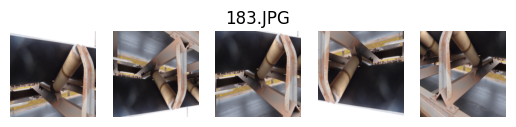

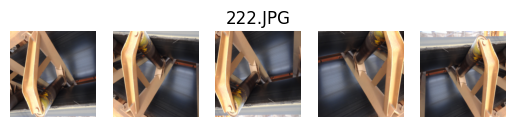

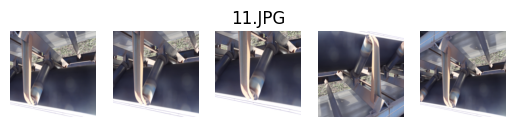

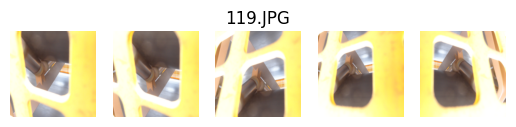

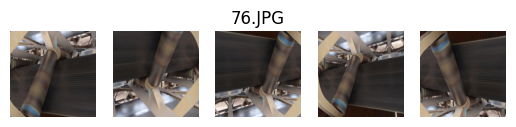

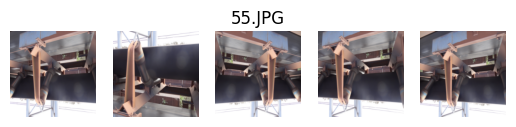

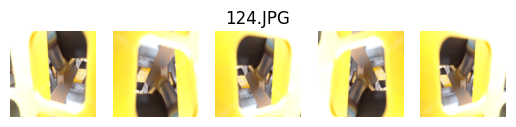

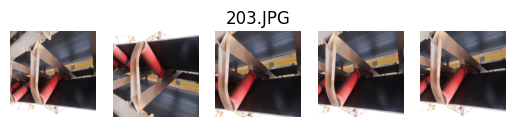

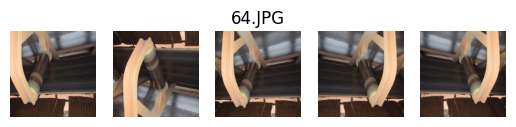

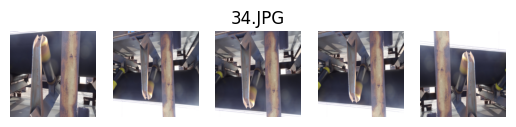


                10/162:
                elapsed:  11.84
                eta:  201.31
                 


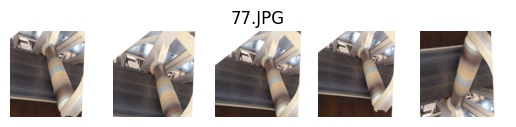

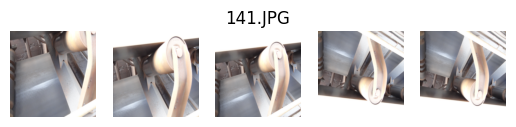

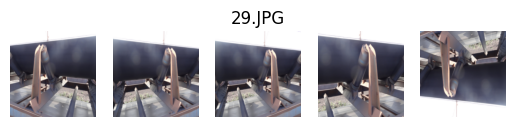

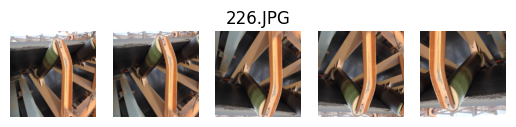

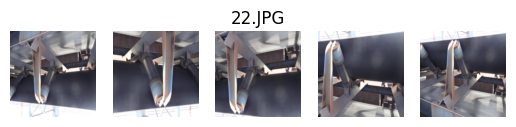

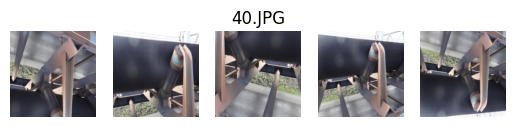

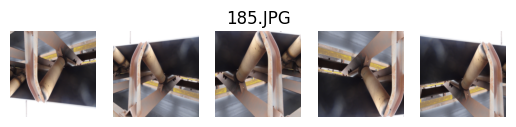

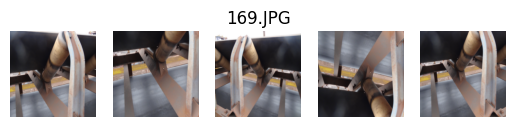

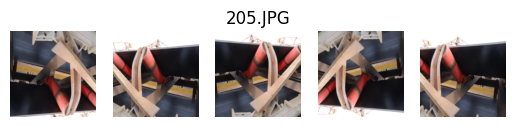

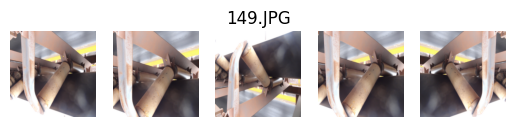


                20/162:
                elapsed:  23.85
                eta:  179.49
                 


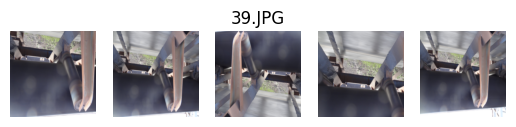

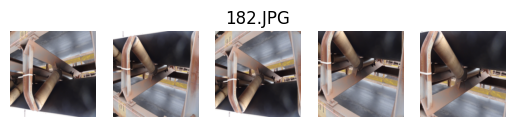

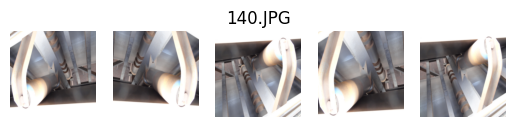

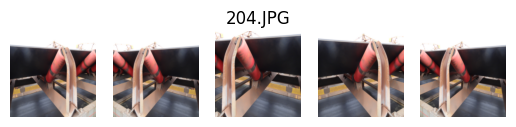

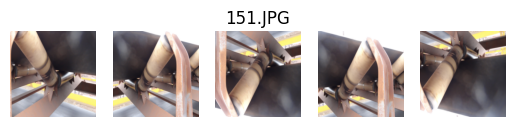

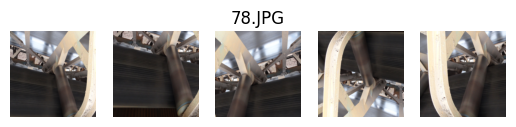

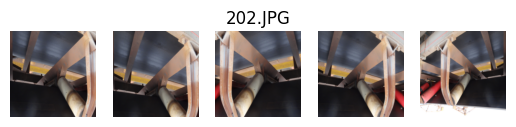

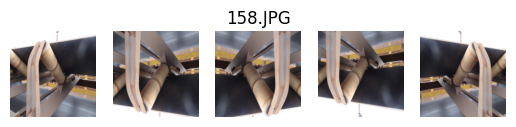

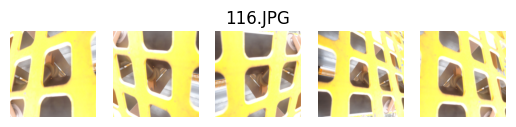

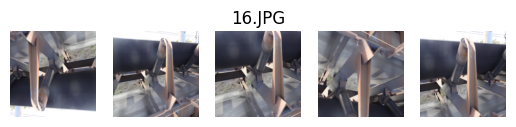


                30/162:
                elapsed:  34.98
                eta:  160.41
                 


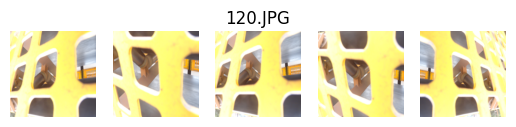

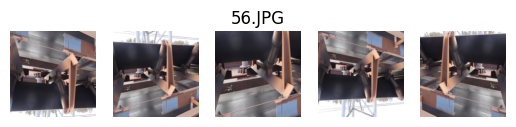

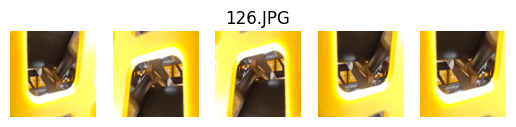

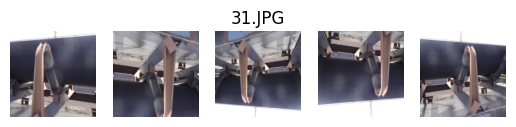

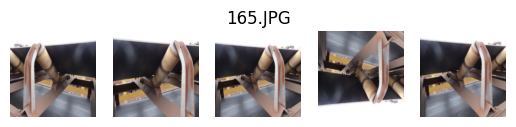

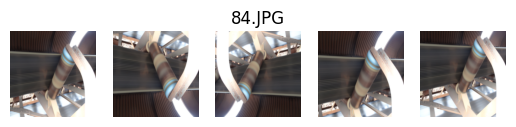

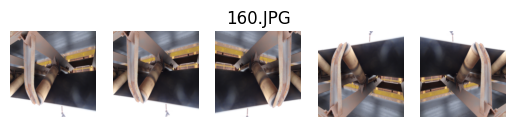

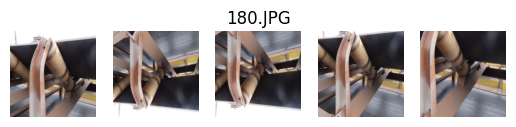

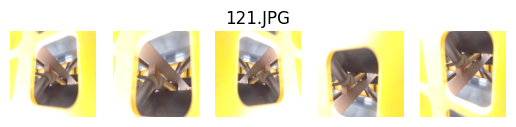

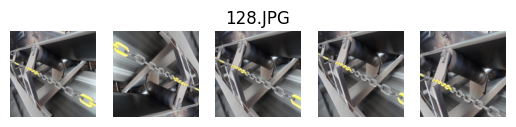


                40/162:
                elapsed:  46.82
                eta:  147.67
                 


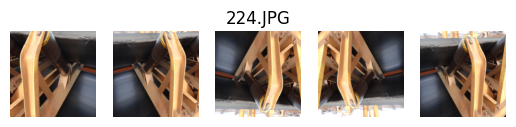

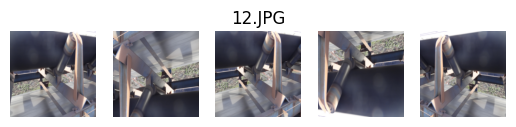

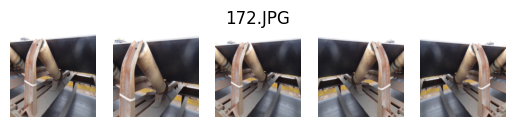

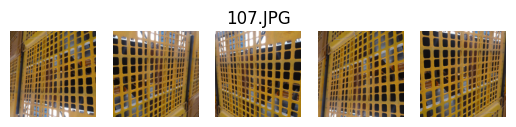

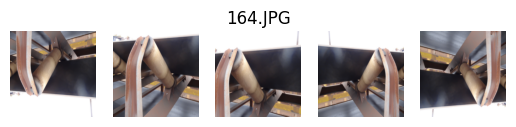

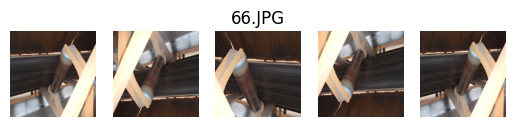

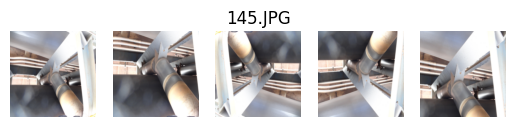

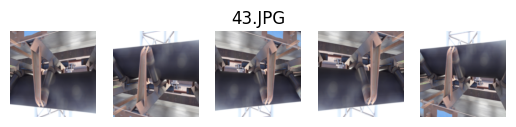

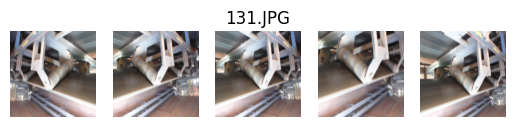

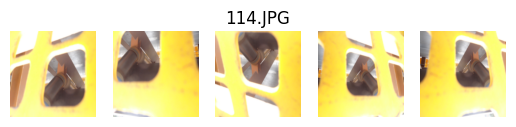


                50/162:
                elapsed:  58.08
                eta:  133.94
                 


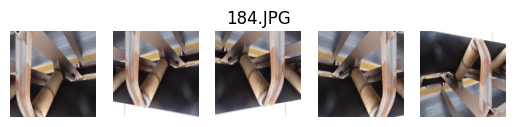

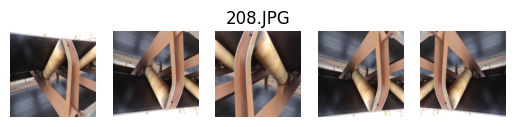

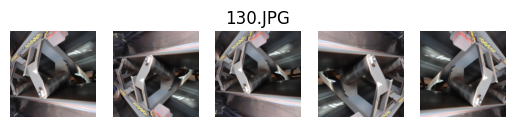

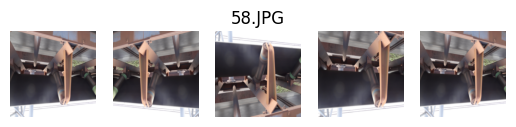

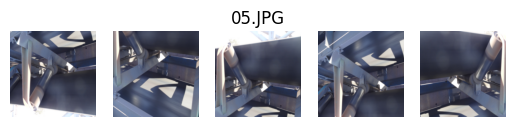

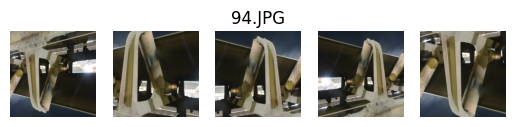

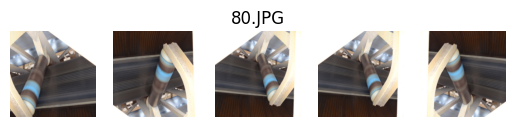

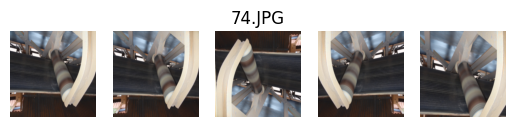

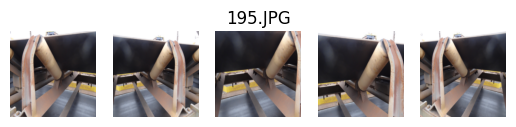

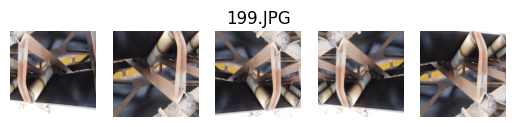


                60/162:
                elapsed:  69.51
                eta:  121.35
                 


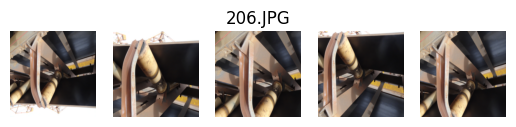

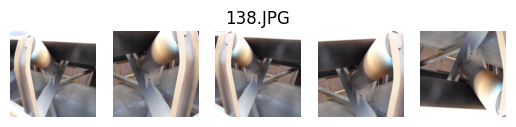

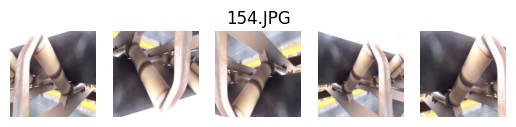

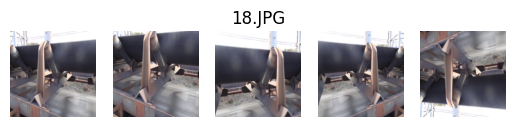

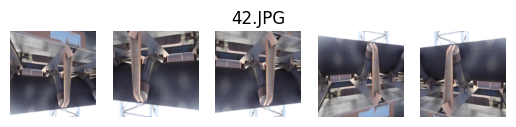

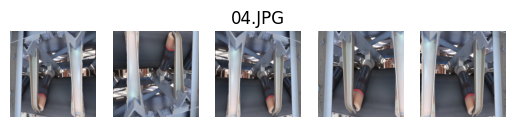

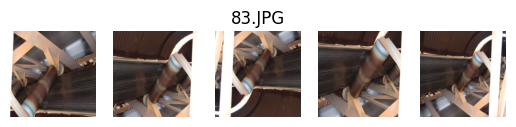

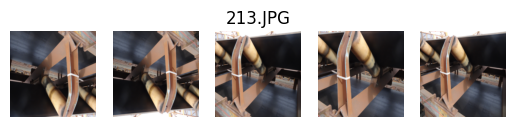

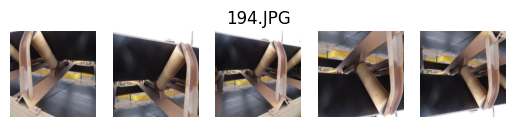

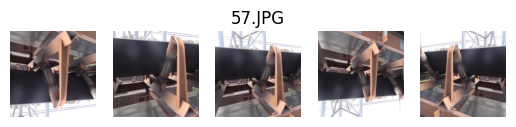


                70/162:
                elapsed:  81.12
                eta:  109.33
                 


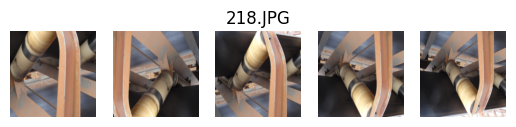

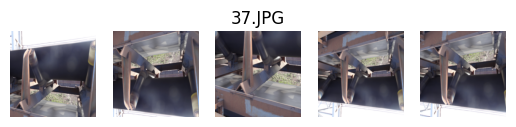

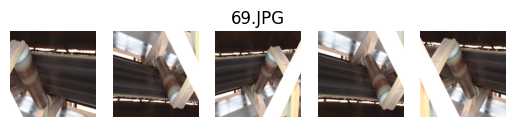

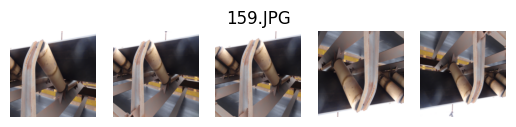

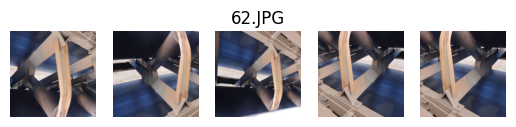

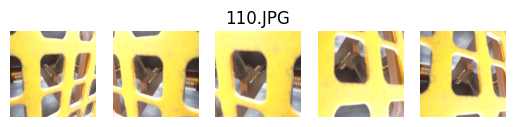

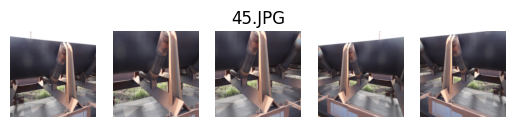

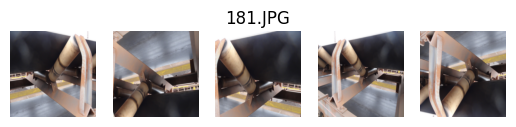

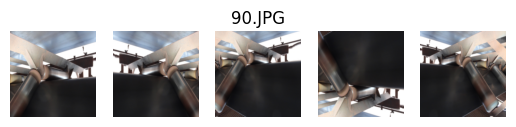

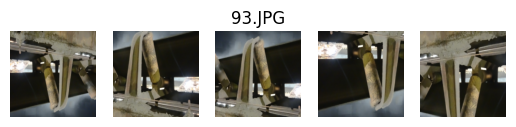


                80/162:
                elapsed:  92.29
                eta:  96.96
                 


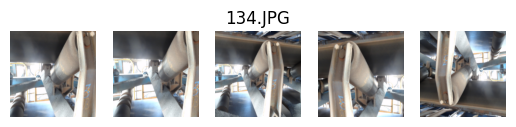

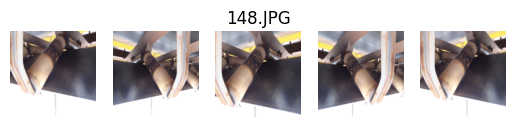

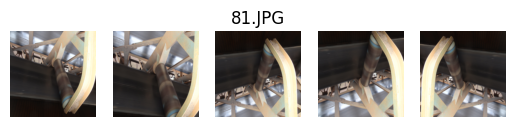

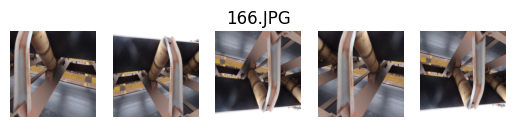

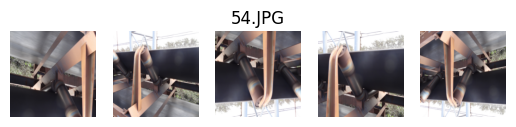

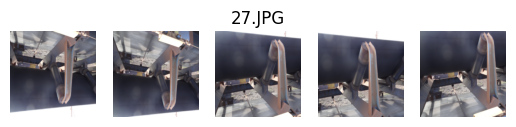

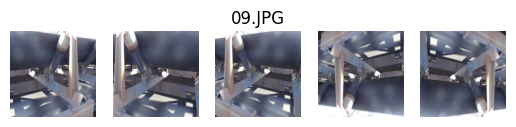

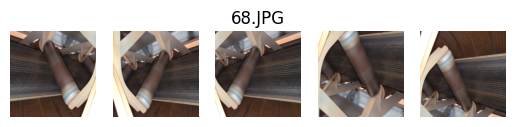

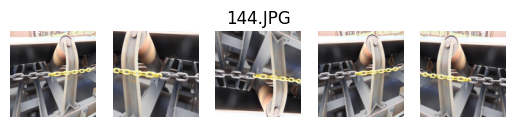

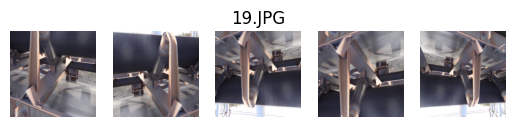


                90/162:
                elapsed:  103.38
                eta:  84.79
                 


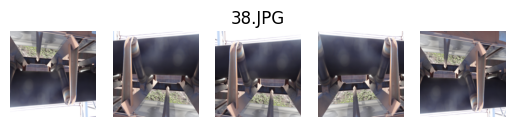

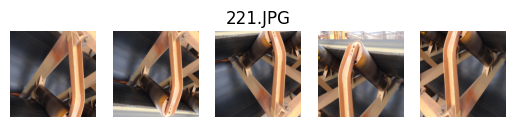

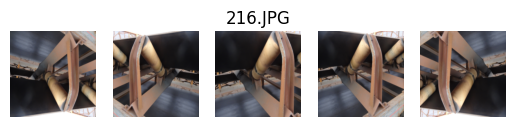

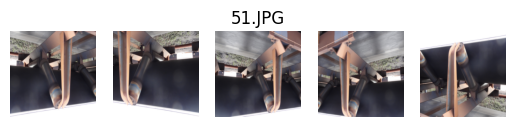

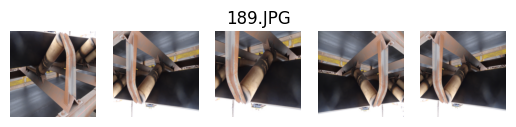

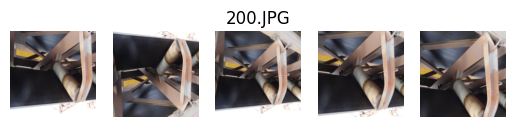

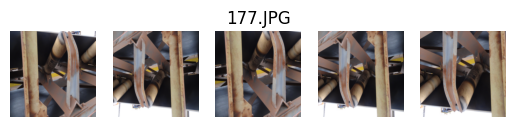

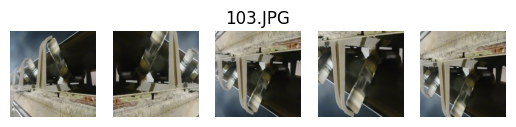

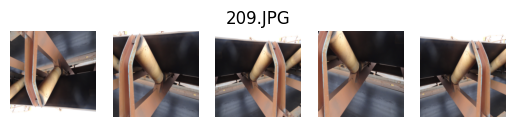

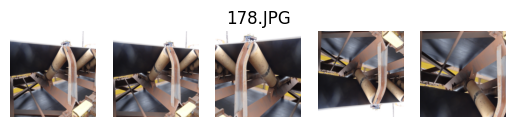


                100/162:
                elapsed:  114.02
                eta:  72.56
                 


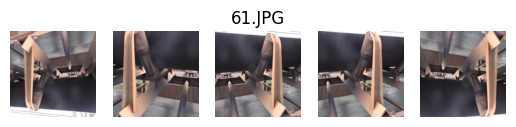

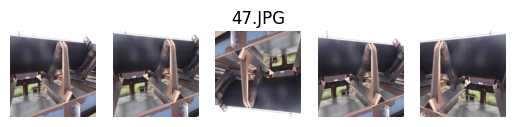

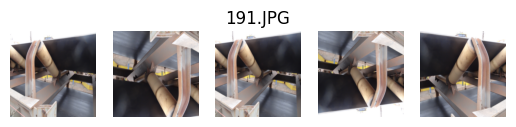

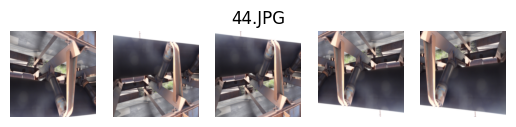

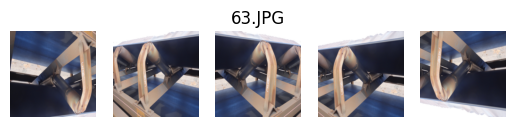

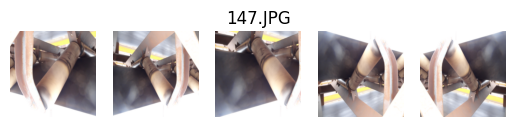

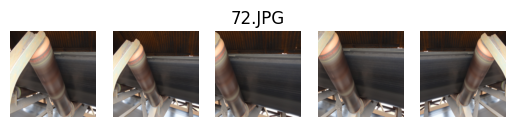

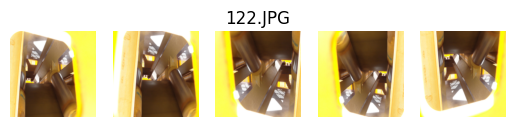

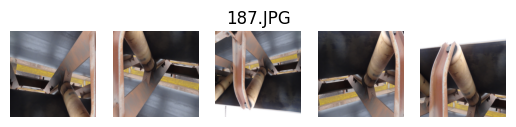

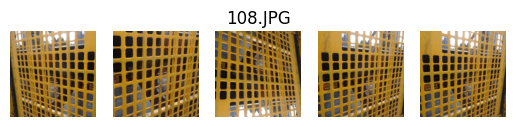


                110/162:
                elapsed:  128.13
                eta:  62.30
                 


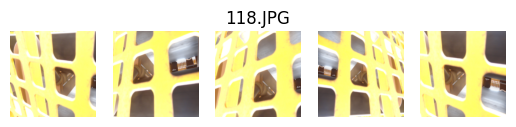

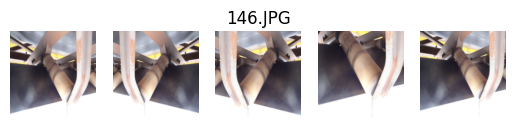

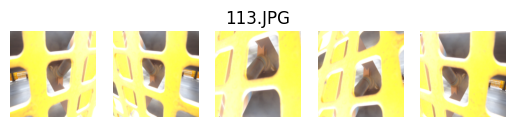

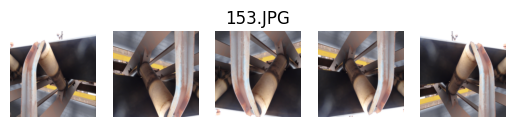

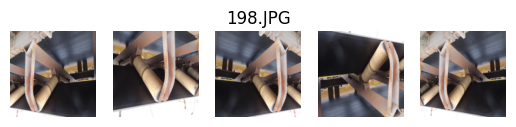

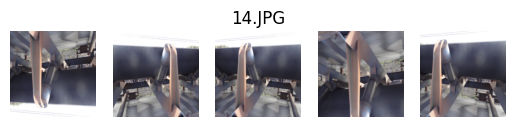

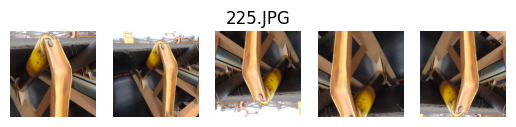

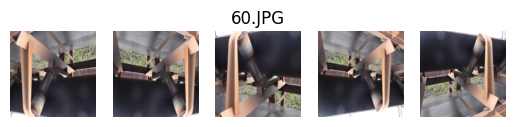

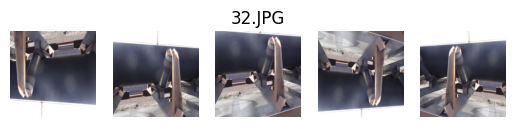

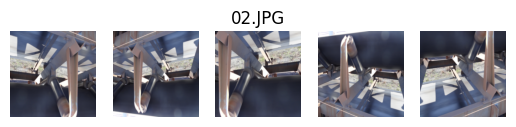


                120/162:
                elapsed:  144.56
                eta:  52.24
                 


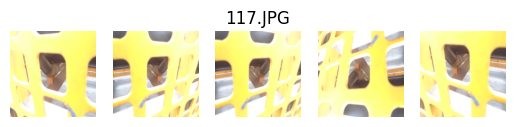

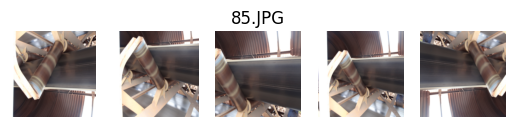

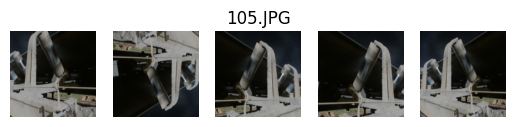

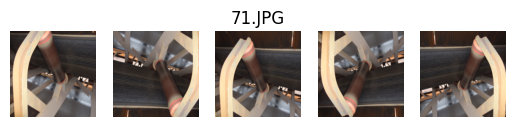

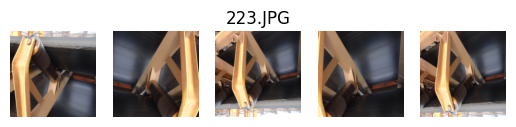

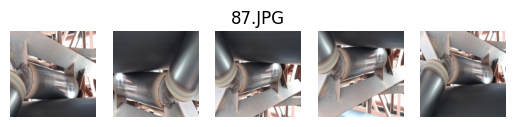

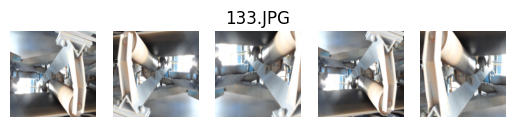

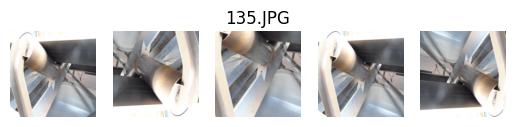

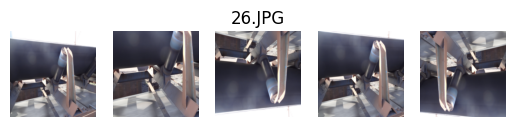

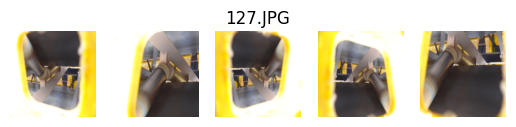


                130/162:
                elapsed:  158.85
                eta:  40.64
                 


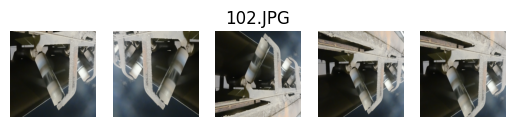

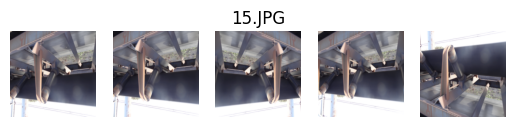

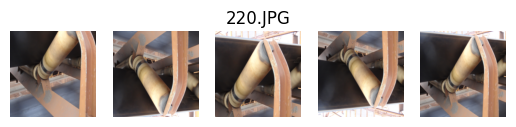

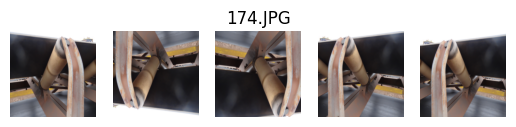

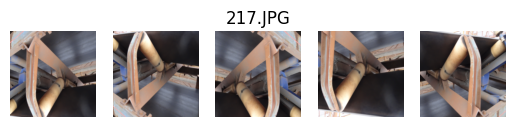

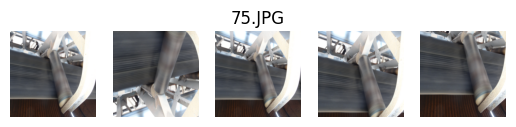

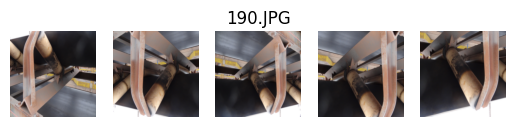

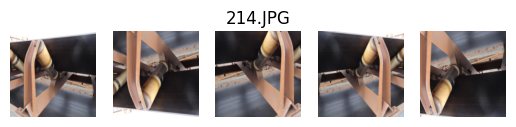

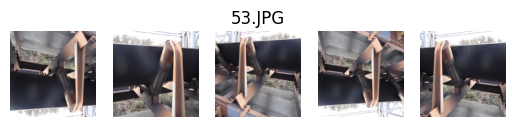

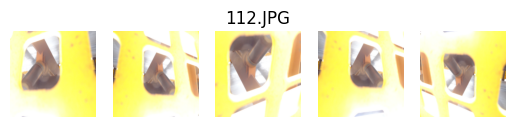


                140/162:
                elapsed:  171.91
                eta:  28.45
                 


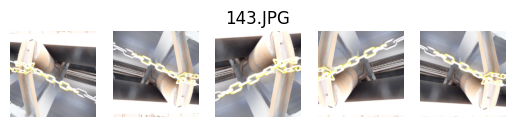

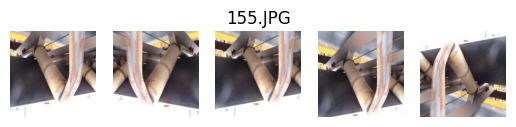

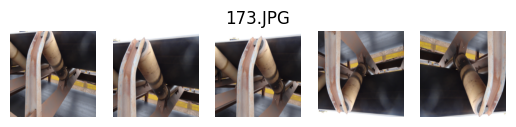

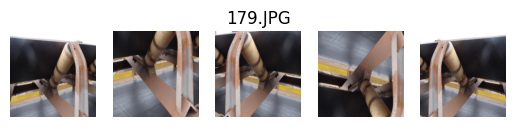

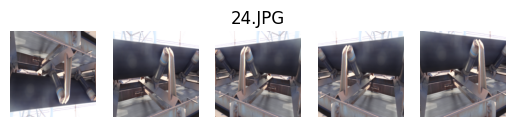

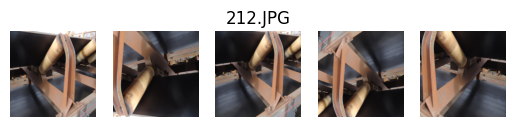

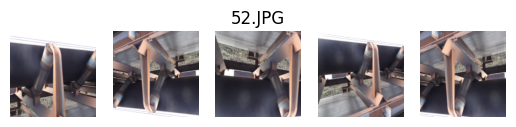

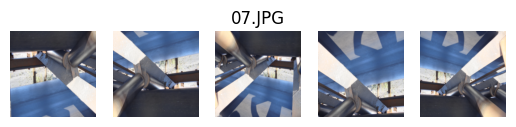

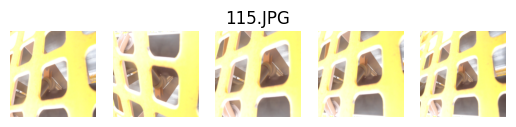

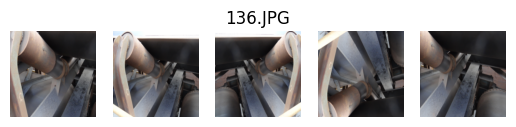


                150/162:
                elapsed:  183.37
                eta:  16.00
                 


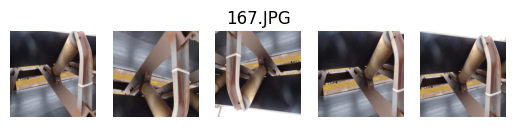

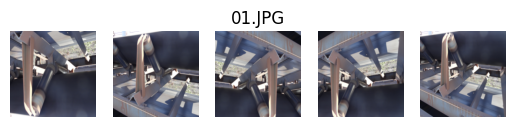

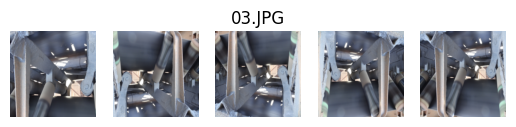

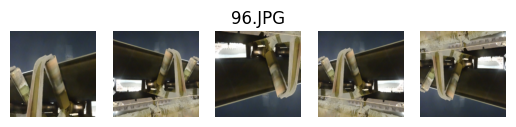

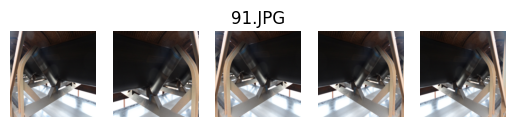

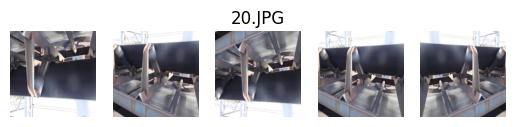

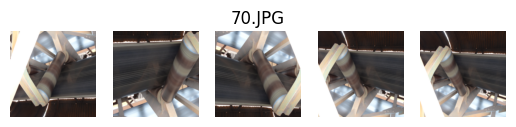

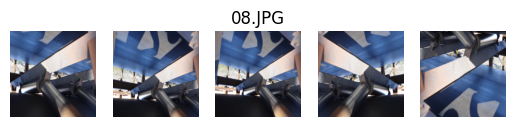

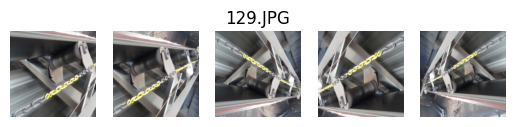

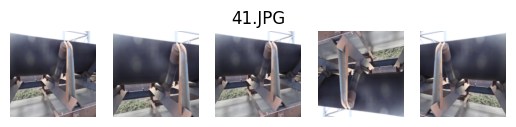


                160/162:
                elapsed:  195.66
                eta:  3.69
                 


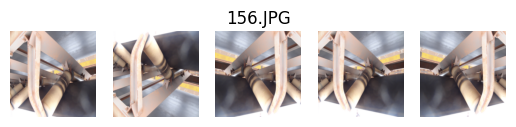

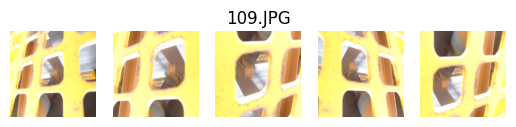


                162/162:
                elapsed:  198.11
                eta:  1.23
                 



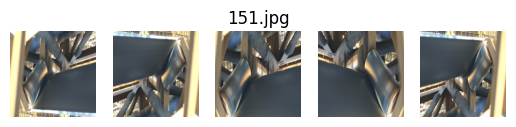

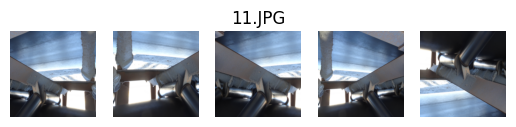

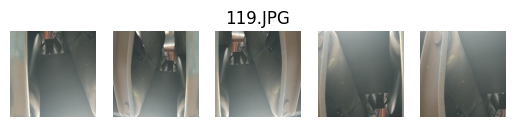

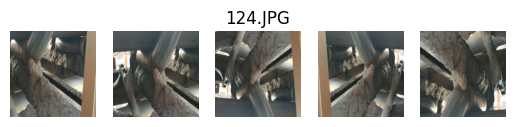

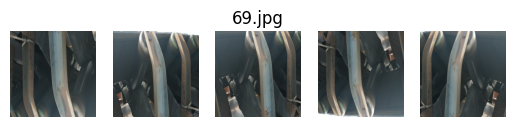

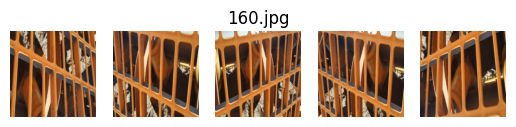

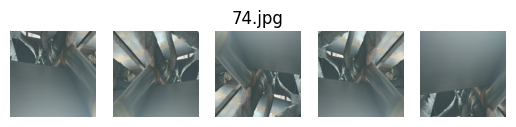

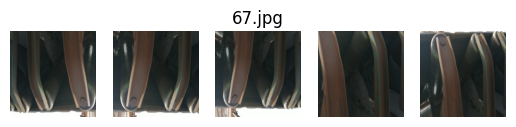

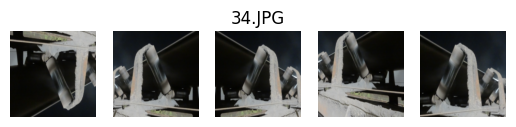

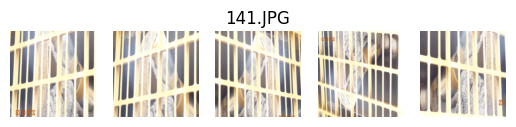


                10/161:
                elapsed:  6.61
                eta:  111.63
                 


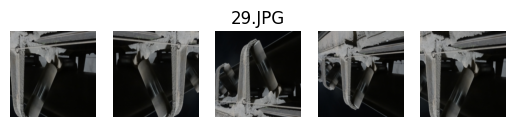

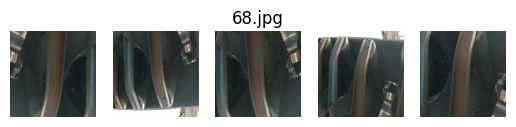

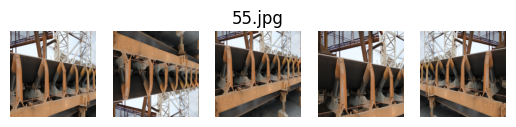

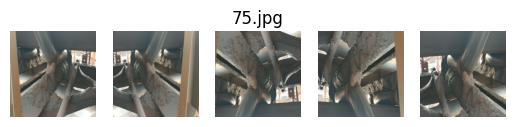

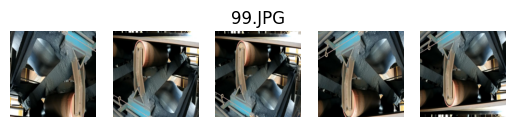

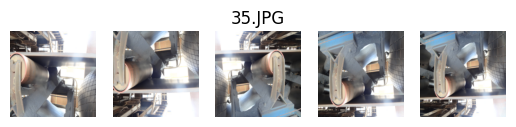

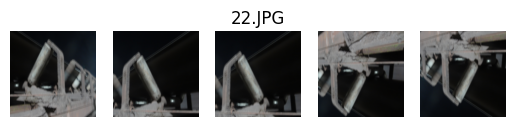

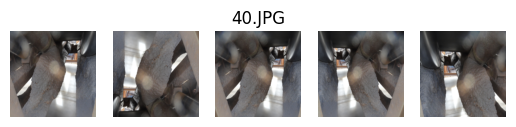

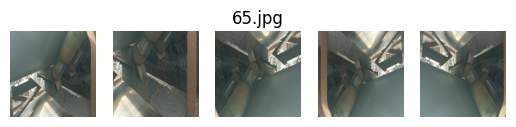

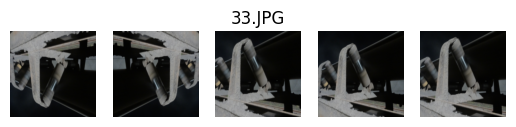


                20/161:
                elapsed:  14.53
                eta:  108.57
                 


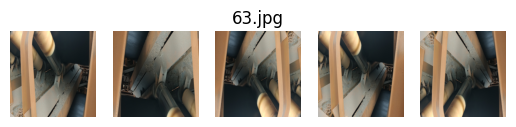

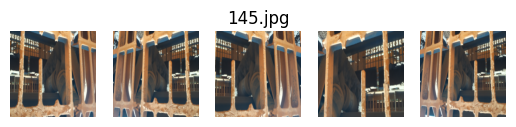

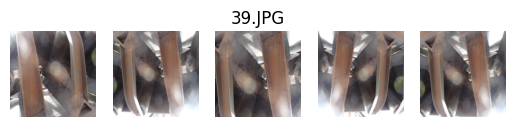

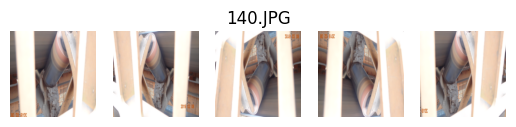

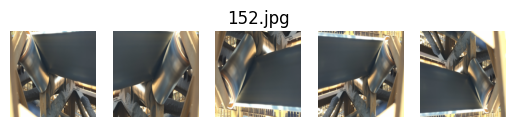

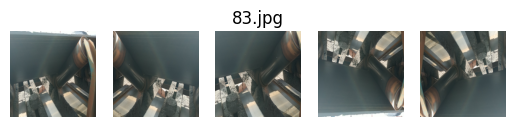

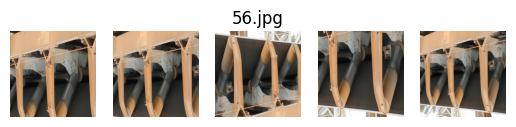

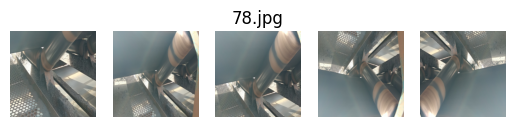

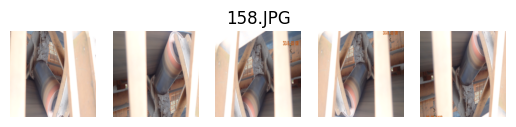

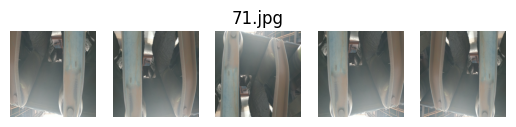


                30/161:
                elapsed:  21.73
                eta:  98.89
                 


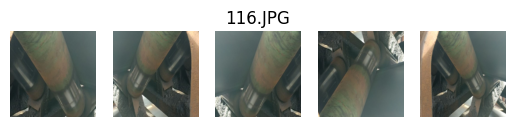

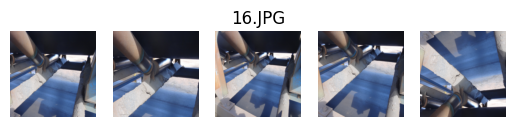

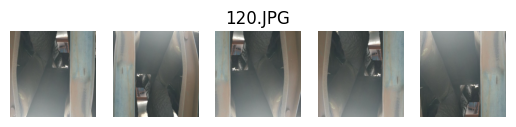

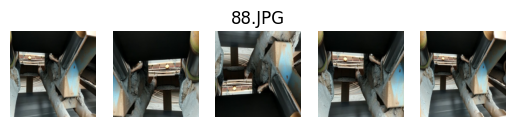

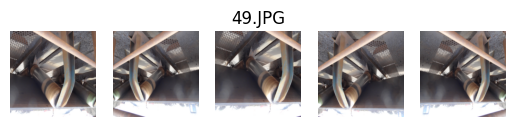

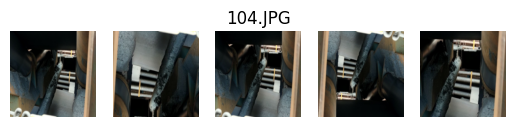

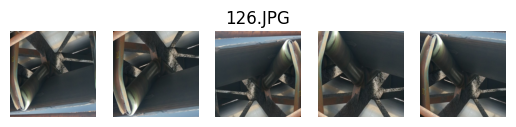

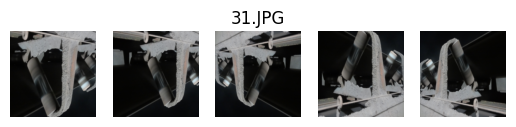

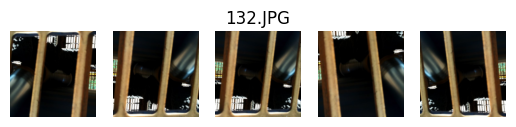

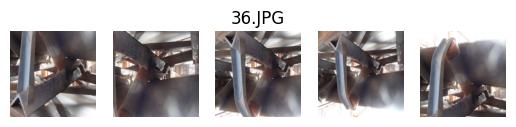


                40/161:
                elapsed:  29.56
                eta:  92.48
                 


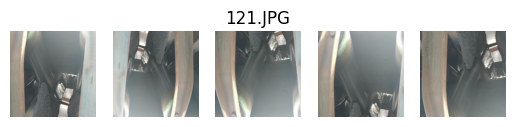

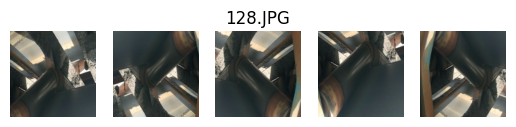

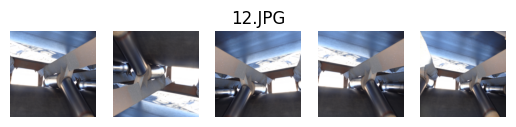

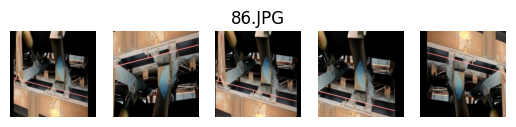

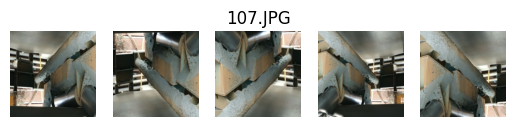

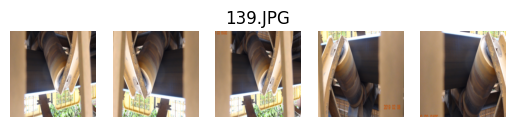

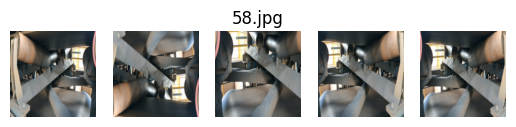

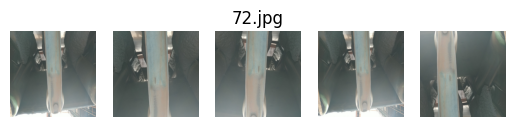

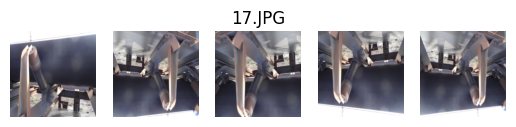

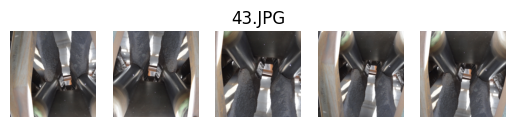


                50/161:
                elapsed:  37.45
                eta:  85.60
                 


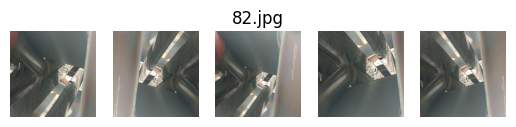

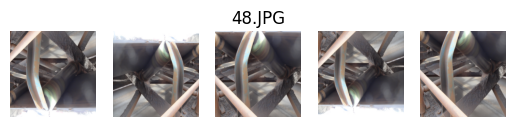

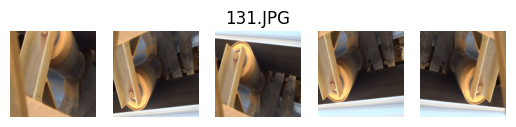

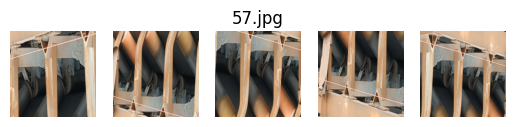

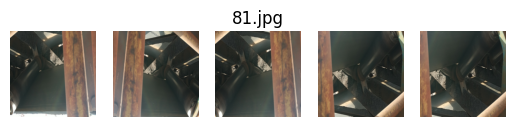

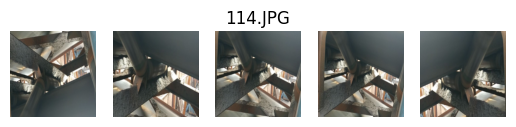

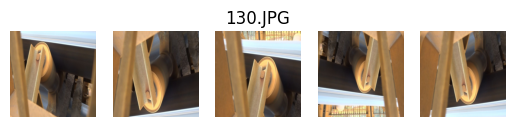

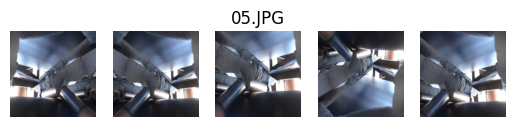

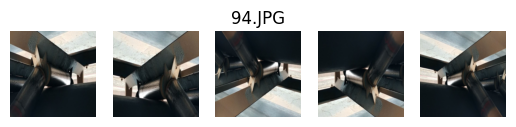

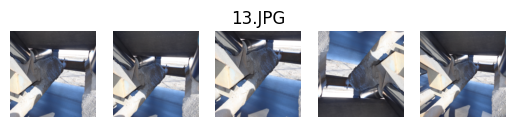


                60/161:
                elapsed:  44.26
                eta:  76.51
                 


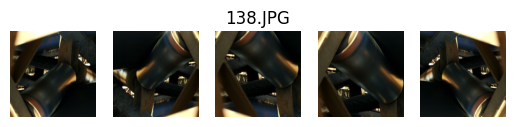

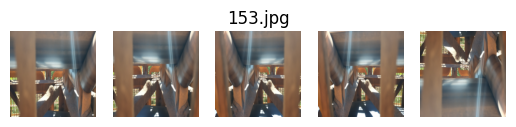

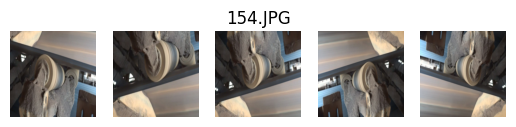

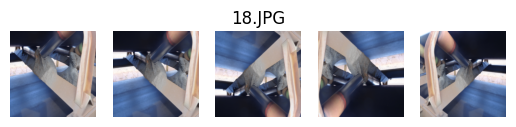

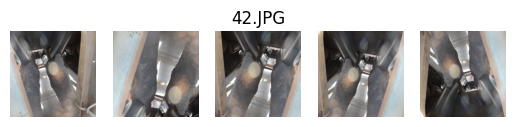

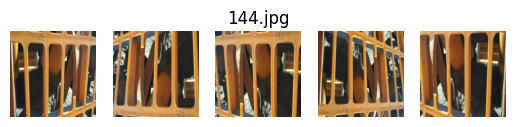

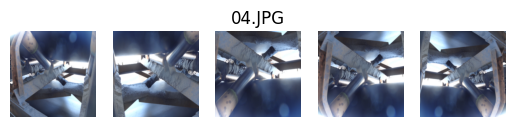

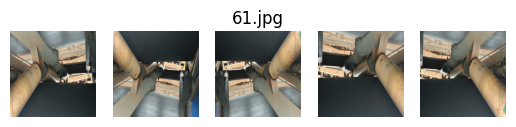

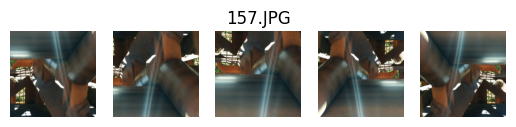

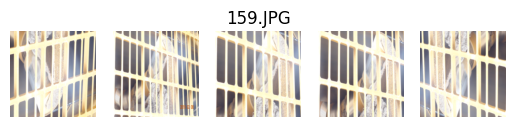


                70/161:
                elapsed:  52.00
                eta:  69.34
                 


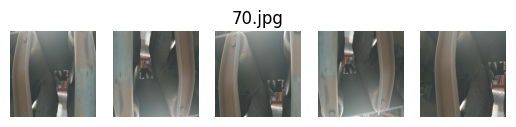

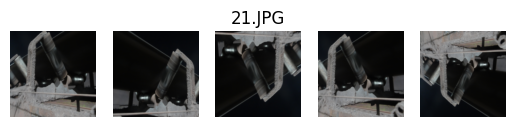

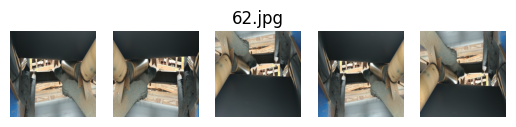

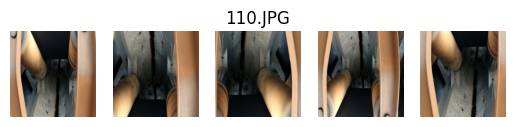

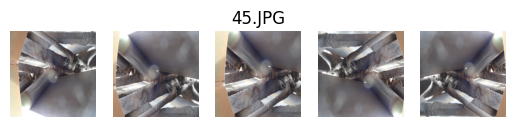

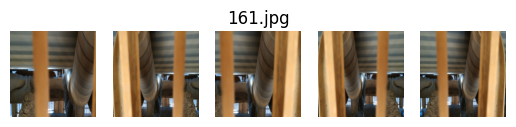

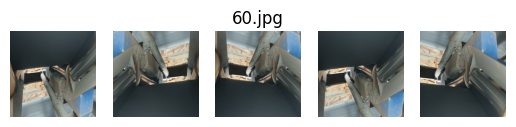

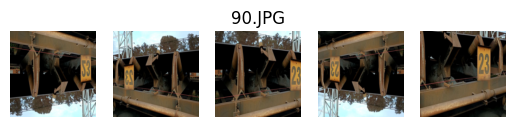

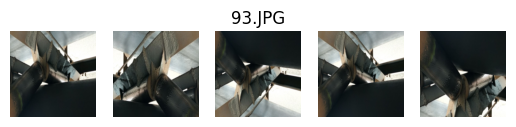

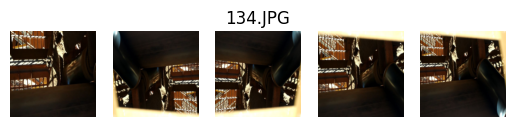


                80/161:
                elapsed:  58.52
                eta:  60.75
                 


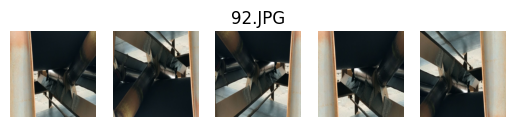

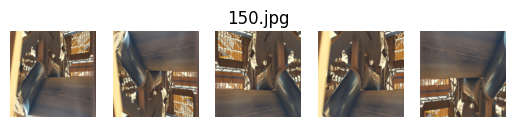

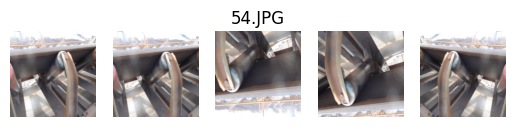

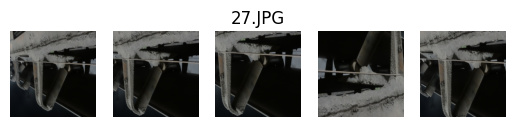

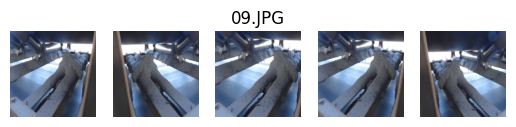

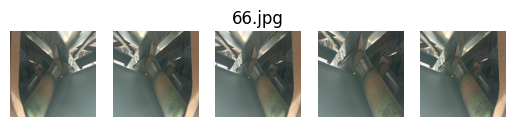

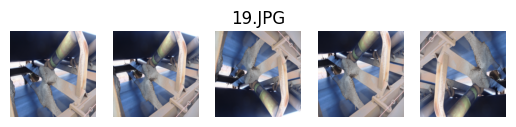

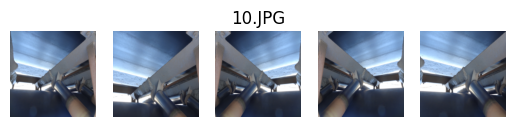

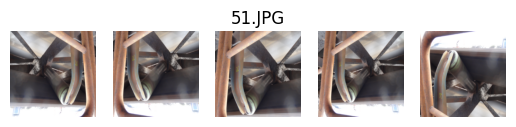

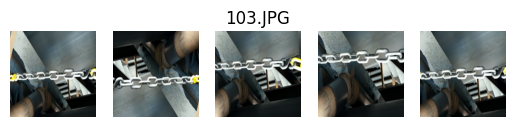


                90/161:
                elapsed:  71.17
                eta:  57.57
                 


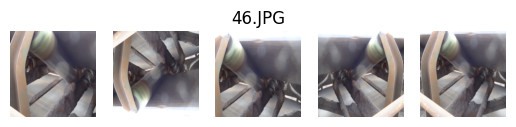

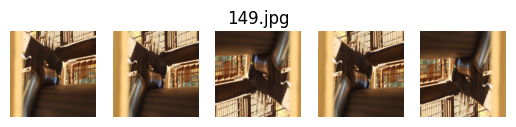

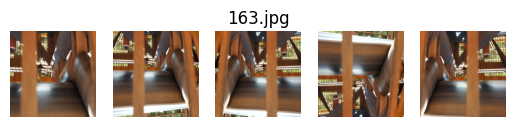

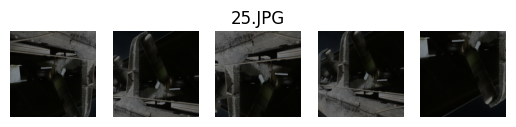

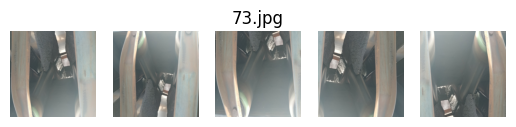

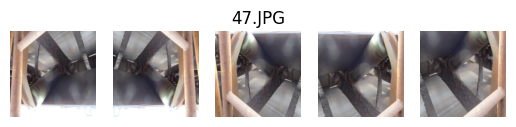

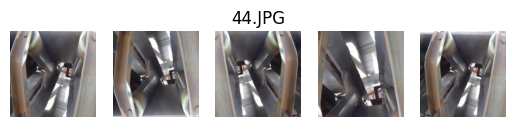

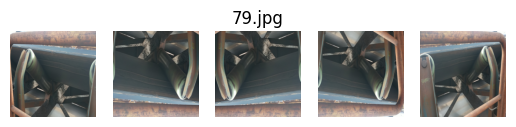

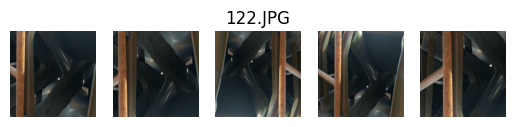

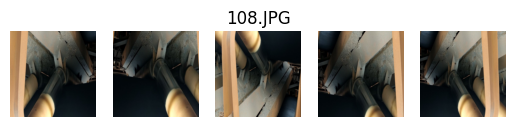


                100/161:
                elapsed:  78.64
                eta:  49.25
                 


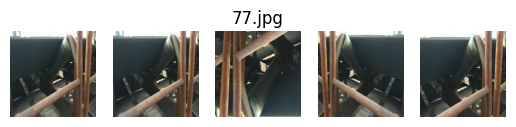

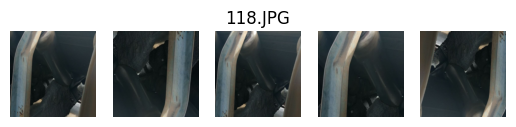

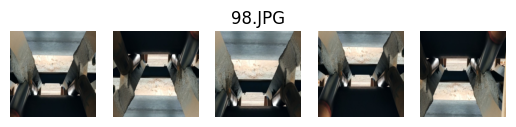

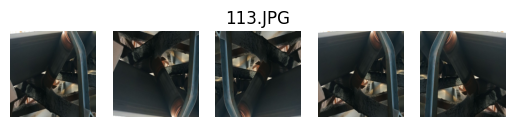

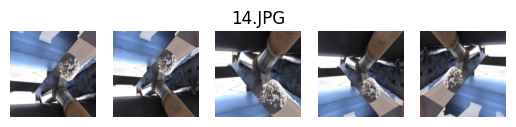

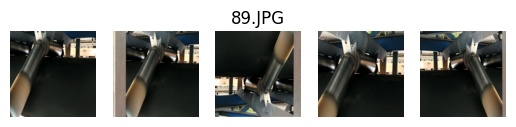

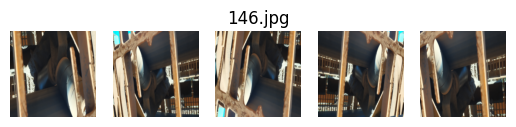

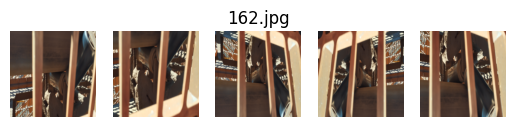

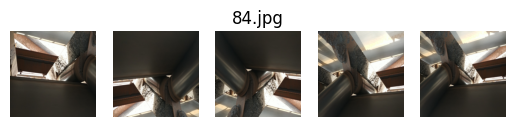

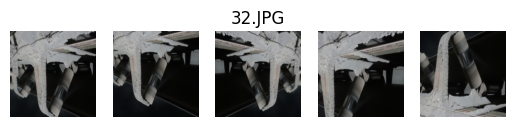


                110/161:
                elapsed:  85.97
                eta:  41.01
                 


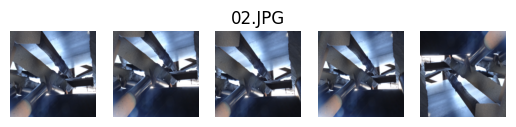

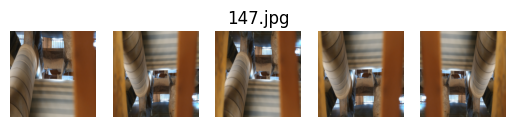

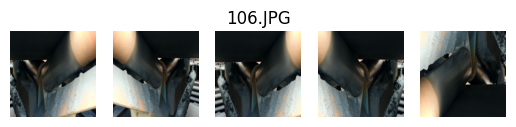

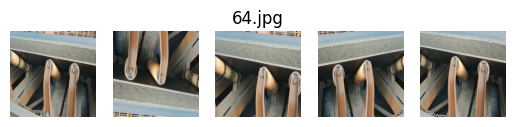

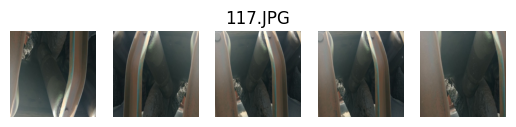

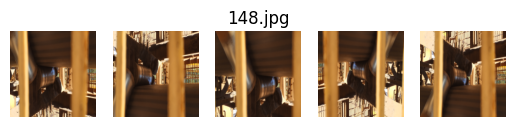

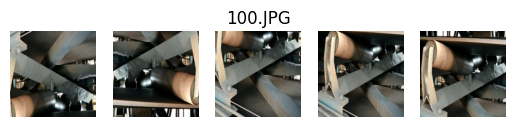

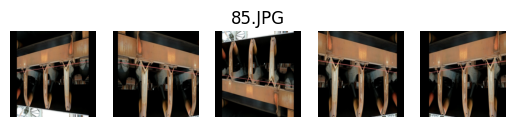

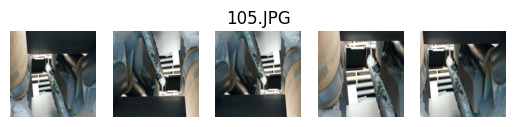

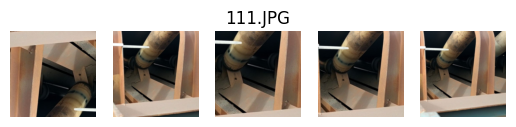


                120/161:
                elapsed:  91.81
                eta:  32.41
                 


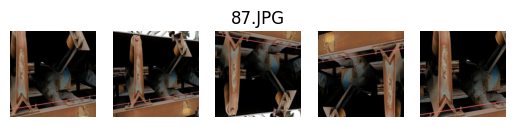

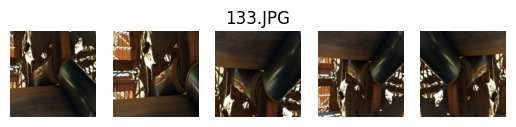

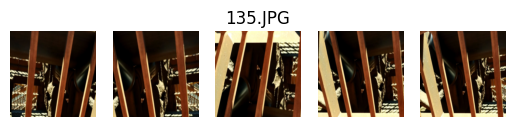

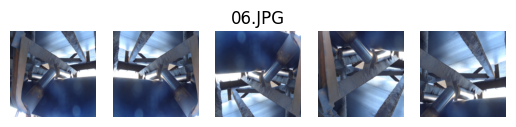

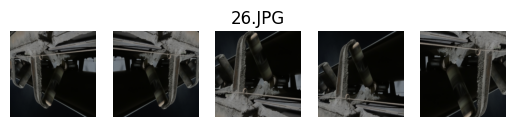

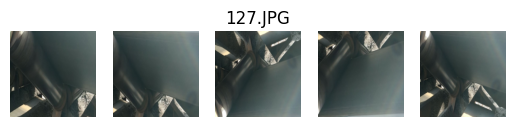

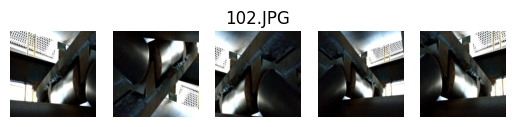

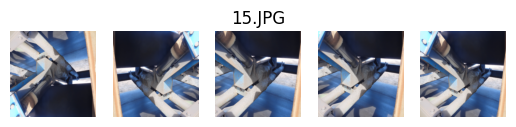

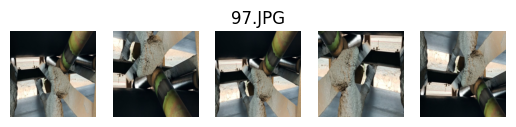

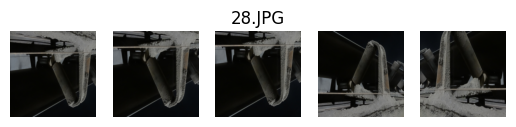


                130/161:
                elapsed:  99.89
                eta:  24.78
                 


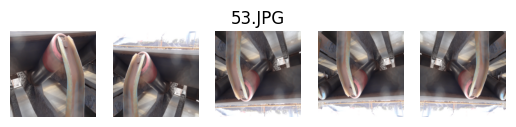

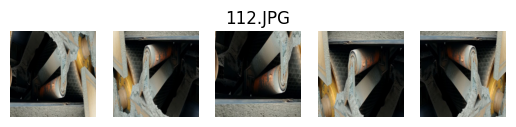

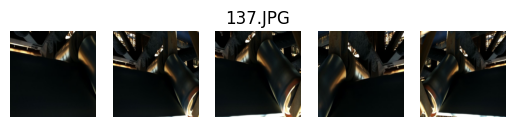

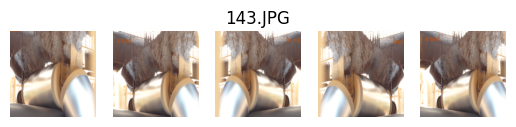

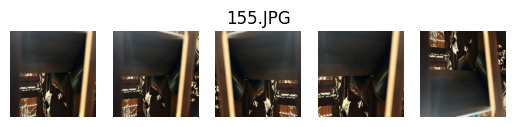

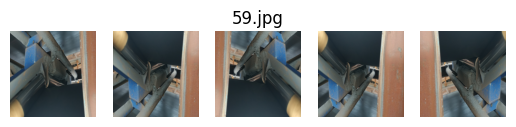

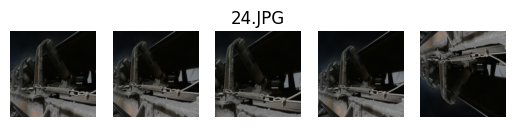

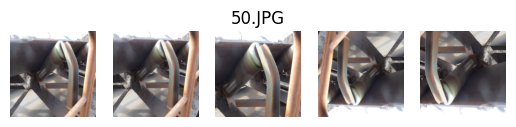

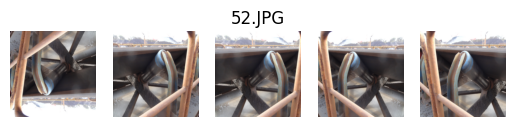

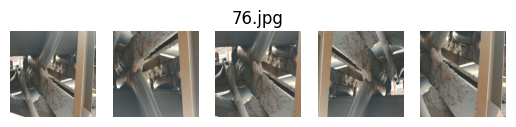


                140/161:
                elapsed:  108.43
                eta:  17.16
                 


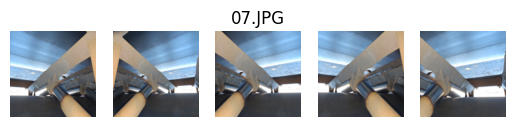

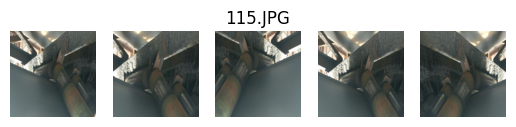

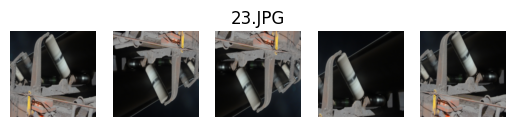

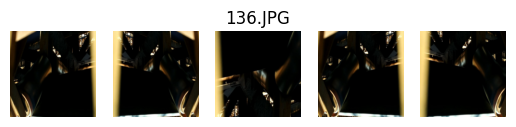

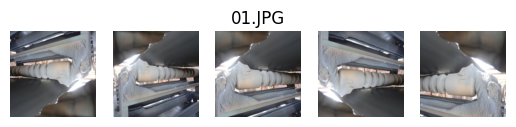

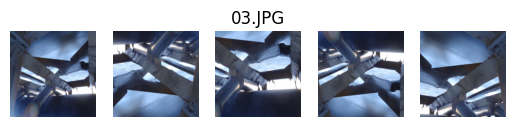

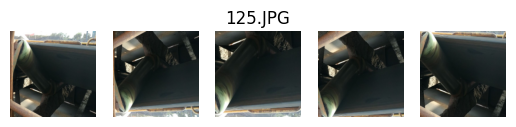

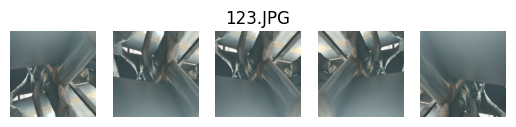

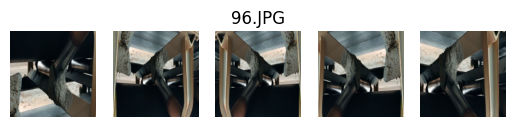

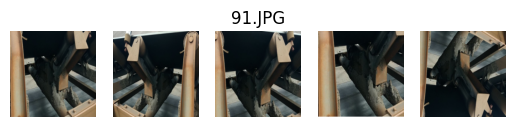


                150/161:
                elapsed:  115.76
                eta:  9.32
                 


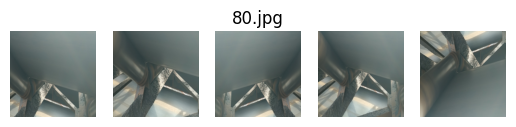

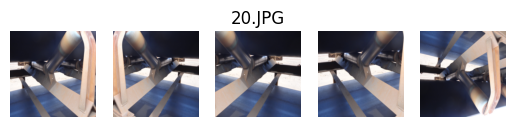

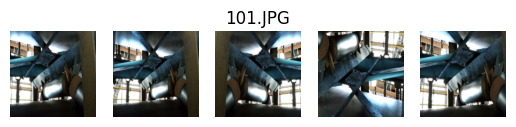

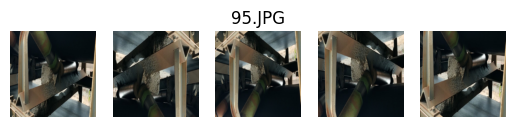

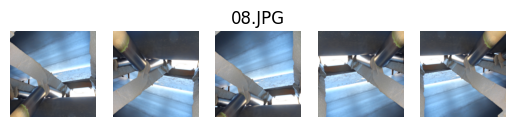

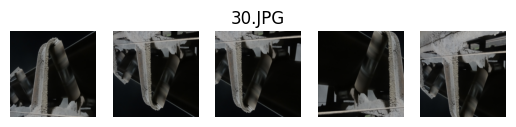

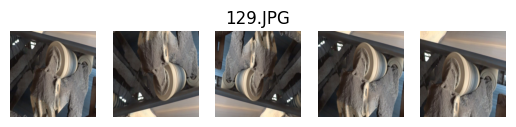

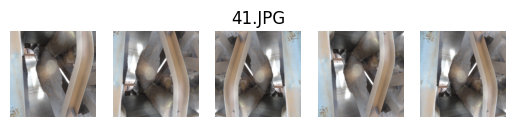

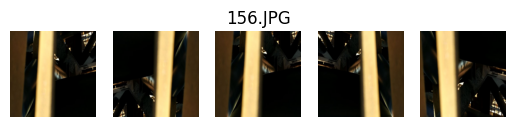

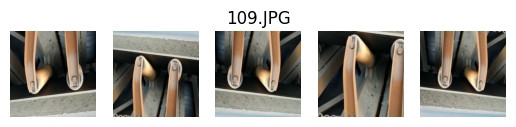


                160/161:
                elapsed:  124.11
                eta:  1.56
                 


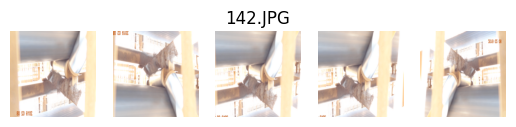


                161/161:
                elapsed:  125.95
                eta:  0.79
                 


In [8]:
if "train" not in os.listdir():
  undersampling()
  convert_images()
  split_data()

In [6]:
# Preparing data loaders
transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
])

train_dataset = ImageFolder(root="train", transform=transform)
train_loader = DataLoader(
    train_dataset,
    batch_size=16,
    shuffle=True,
    num_workers=1
)

test_dataset = ImageFolder(root="test", transform=transform)
test_loader = DataLoader(
    test_dataset,
    batch_size=16,
    shuffle=False,
    num_workers=1
)

In [96]:
def train_epoch(train_loader, device):
    running_loss = 0.0
    correct = 0
    total = 0
    for images, labels in train_loader:
        # Move data to GPU
        images, labels = images.to(device), labels.to(device)

        optimizer.zero_grad()
        outputs = model(images)
        labels = labels.view(-1, 1).float()
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()

        running_loss += loss.item()
        predicted = torch.round(outputs)
        total += labels.size(0)
        correct += (predicted == labels).sum().item()
    epoch_loss = running_loss / len(train_loader)
    accuracy = 100 * correct / total
    print(f"Loss: {epoch_loss:.4f}, Accuracy: {accuracy:.2f}%")

In [97]:
def evaluate_epoch(test_loader, device):
    test_loss = 0.0
    test_correct = 0
    test_total = 0
    with torch.no_grad():
      for images, labels in test_loader:
          images, labels = images.to(device), labels.to(device)

          outputs = model(images)
          labels = labels.view(-1, 1).float()
          test_loss += criterion(outputs, labels).item()

          predicted = torch.round(outputs)
          test_total += labels.size(0)
          test_correct += (predicted == labels).sum().item()
    test_epoch_loss = test_loss / len(test_loader)
    test_accuracy = 100 * test_correct / test_total
    print(f"Loss: {test_epoch_loss:.4f}, Accuracy: {test_accuracy:.2f}%")

In [107]:
# Defining the model
class DirtDetector(nn.Module):
  def __init__(self):
    super(DirtDetector, self).__init__()
    self.conv1 = nn.Conv2d(3, 16, kernel_size=3, padding=1)
    self.conv2 = nn.Conv2d(16, 32, kernel_size=3, padding=1)
    self.fc1 = nn.Linear(32 * 56 * 56, 128)
    self.fc2 = nn.Linear(128, 1)
    self.sigmoid = nn.Sigmoid()

  def forward(self, x):
    x = F.relu(self.conv1(x))
    x = F.max_pool2d(x, 2)
    x = F.relu(self.conv2(x))
    x = F.max_pool2d(x, 2)
    x = x.view(-1, 32 * 56 * 56)
    x = F.relu(self.fc1(x))
    x = self.fc2(x)
    x = self.sigmoid(x)
    return x

In [108]:
model = DirtDetector()

# Define loss function and optimizer
criterion = nn.BCELoss()
optimizer = optim.Adam(model.parameters(), lr=0.001)

In [109]:
def train(train_loader, test_loader=None, epoch_size=5):
  device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
  model.to(device)
  for epoch in range(epoch_size):
    print(f"Epoch [{epoch+1}/{epoch_size}]")
    print("Training...")
    train_epoch(train_loader, device)
    print("Testing...")
    evaluate_epoch(test_loader, device)

In [110]:
train(train_loader, test_loader, epoch_size=5)

Epoch [1/5]
Training...


RuntimeError: shape '[4, 1]' is invalid for input of size 16

In [88]:
torch.save(model.state_dict(), 'dirt_detector.pth')